# Metadata

```yaml
course:   DS 5001 
module:   05 5 Lab
topic:    Vector Spaces, BOW, and TFIDF
author:   R.C. Alvarado
date:     12 February 2023 (revised)
```

# Overview

In this notebook, we explore Luhn's concept of term significance in light of Zipf's Law, TFIDF, and vector space models of text. 

We will be looking for a significance function that will approximate the dotted line below.

Recall Luhn's (1958) representation of the problem:

<img src="./data_in/luhn.png"/>

In this notebook, we look at ways to approximate the significance curve using the ideas we learned in this module.

# Set Up

## Config

Change this to match the location of your data files.

In [1]:
data_in = '../../lessons/data/output'
data_out = '../../lessons/data/output'
data_prefix = 'austen-melville'

## Hyperparameters

These are some of the hyperparameters that will affect the computation of TFIDF.

In [2]:
tf_method = 'sum'         # sum, max, log, double_norm, raw, binary
tf_norm_k = .5            # only used for double_norm
idf_method = 'standard'   # standard, max, smooth
gradient_cmap = 'YlGnBu'  # YlGn, GnBu, YlGnBu; For tables; see https://matplotlib.org/3.1.0/tutorials/colors/colormaps.html 

OHCO = ['book_id', 'chap_num', 'para_num', 'sent_num', 'token_num']
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [3]:
bag = CHAPS

## Import

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [5]:
sns.set()

# Prepare the data

## Import tables

In [6]:
LIB = pd.read_csv(f"{data_in}/{data_prefix}-LIB.csv").set_index(BOOKS)
TOKEN = pd.read_csv(f'{data_in}/{data_prefix}-TOKEN.csv').set_index(OHCO).dropna()
VOCAB = pd.read_csv(f'{data_in}/{data_prefix}-VOCAB.csv').set_index('term_str').dropna()
POS_GROUP = pd.read_csv(f'{data_in}/{data_prefix}-POS_GROUP.csv').set_index('pos_group')

In [7]:
POS_GROUP

,n,def,p,i,h
pos_group,,,,,
CC,83450,"conjunction, coordinating",0.040530,4.624859,0.187446
CD,12610,"numeral, cardinal",0.006124,7.351202,0.045022
DT,204813,determiner,0.099474,3.329535,0.331203
EX,3776,existential there,0.001834,9.090840,0.016672
FW,490,foreign word,0.000238,12.036845,0.002865
IN,264122,"preposition or conjunction, subordinating",0.128279,2.962638,0.380046
JJ,165133,"adjective or numeral, ordinal; adjective, co...",0.080202,3.640214,0.291953
LS,3,list item marker,0.000001,19.388520,0.000028
MD,31876,modal auxiliary,0.015482,6.013300,0.093096


In [8]:
LIB

,source_file_path,author,title,chap_regex,book_len,n_chaps
book_id,,,,,,
105,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",PERSUASION,^Chapter\s+\d+$,83624,24
121,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",NORTHANGER ABBEY,^CHAPTER\s+\d+$,77601,31
141,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",MANSFIELD PARK,^CHAPTER\s+[IVXLCM]+$,160378,48
158,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",EMMA,^\s*CHAPTER\s+[IVXLCM]+\s*$,160926,55
161,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",SENSE AND SENSIBILITY,^CHAPTER\s+\d+$,119873,50
946,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",LADY SUSAN,^\s*[IVXLCM]+\s*$,23116,41
1212,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",LOVE AND FREINDSHIP SIC,^\s*LETTER .* to .*$,33265,24
1342,../data/gutenberg/austen-melville-set/AUSTEN_J...,"AUSTEN, JANE",PRIDE AND PREJUDICE,^Chapter\s+\d+$,122126,61
1900,../data/gutenberg/austen-melville-set/MELVILLE...,"MELVILLE, HERMAN",TYPEE A ROMANCE OF THE SOUTH SEAS,^CHAPTER,108021,34


In [9]:
VOCAB

,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,
0,2,1,9.713651e-07,19.973483,CD,1,{'CD'},0,0,0,0
1,23,1,1.117070e-05,16.449921,CD,3,"{'NN', 'CD', 'NNP'}",0,1,1,1
10,6,2,2.914095e-06,18.388520,CD,1,{'CD'},0,10,10,10
100,2,3,9.713651e-07,19.973483,CD,1,{'CD'},0,100,100,100
1000,2,4,9.713651e-07,19.973483,CD,1,{'CD'},0,1000,1000,1000
...,...,...,...,...,...,...,...,...,...,...,...
æneas,1,5,4.856826e-07,20.973483,NN,1,{'NN'},0,ænea,ænea,ænea
æniad,1,5,4.856826e-07,20.973483,NN,1,{'NN'},0,æniad,æniad,æniad
æson,2,4,9.713651e-07,19.973483,NN,1,{'NN'},0,æson,æson,æson


In [10]:
TOKEN

pos_tuple  pos  \
book_id chap_num para_num sent_num token_num                               
158     1        1        0        0                ('Emma', 'NNP')  NNP   
                                   1          ('Woodhouse,', 'NNP')  NNP   
                                   2            ('handsome,', 'NN')   NN   
                                   3              ('clever,', 'NN')   NN   
                                   4                  ('and', 'CC')   CC   
...                                                             ...  ...   
10712   92       23       0        7                    ('a', 'DT')   DT   
                                   8               ('voyage', 'NN')   NN   
                                   9               ("that's", 'NN')   NN   
                                   10           ('homeward', 'SYM')  SYM   
                                   12              ('bound!', 'NN')   NN   

                                               token_str   term_str  
book_id chap_num para_num sent_num token_num                         
158     1        1        0        0                Emma       emma  
                                   1          Woodhouse,  woodhouse  
                                   2           handsome,   handsome  
                                   3             clever,     clever  
                                   4                 and        and  
...                                                  ...        ...  
10712   92       23       0        7                   a          a  
                                   8              voyage     voyage  
                                   9              that's      thats  
                                   10           homeward   homeward  
                                   12             bound!      bound  

[2070255 rows x 4 columns]

## Keep only POS groups

In [11]:
VOCAB['max_pos'] = VOCAB.max_pos.str[:2]

Let's take a quick peek at the distribution of terms (types) and tokens over POS categories.

In [12]:
POS_GROUP['n_terms'] = VOCAB.max_pos.value_counts() 
POS_GROUP['n_tokens'] = VOCAB.groupby('max_pos').n.sum()

In [13]:
# POS_GROUP.dropna().n_terms.sort_values().plot.bar(figsize=(15,5), rot=45, title="N Terms per POS Group");

In [14]:
# POS_GROUP.dropna().n_tokens.sort_values().plot.bar(figsize=(15,5), rot=45, title="N Tokens per POS Group");

In [15]:
def plot_pos():
    X = POS_GROUP[['n_terms','n_tokens', 'def']].dropna().sort_values('n_terms')
    labels = X['def']
    Z = ((X - X.mean(numeric_only=True)) / X.std(numeric_only=True)).iloc[:,1:]
    return px.bar(Z, height=600, hover_name=labels, title="Comparison of Z-scores for POS token and term counts")

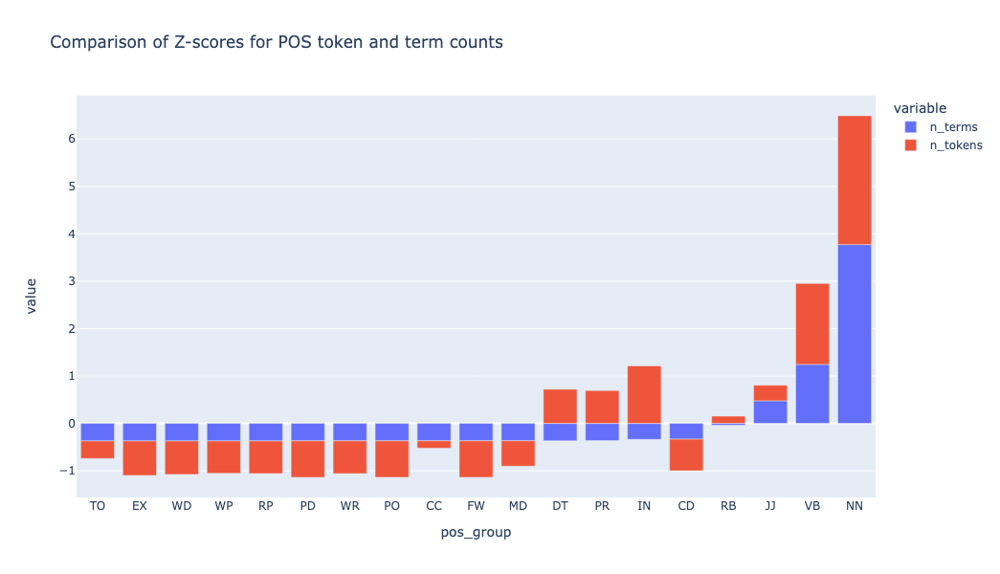

In [16]:
plot_pos()

This provides some insight into the difference between **open** and **closed** categories.

# Explore Zipf's Law

Recall the formula Zipf's law $f \propto \frac{1}{r} $, and $k =  fr$. 

We explore our data to see if it matches the formula.

## Add Term Rank to VOCAB

First, we compute the rank of each word, which is just its numeric index when inversely sorted by frequency.

In [17]:
VOCAB

,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,
0,2,1,9.713651e-07,19.973483,CD,1,{'CD'},0,0,0,0
1,23,1,1.117070e-05,16.449921,CD,3,"{'NN', 'CD', 'NNP'}",0,1,1,1
10,6,2,2.914095e-06,18.388520,CD,1,{'CD'},0,10,10,10
100,2,3,9.713651e-07,19.973483,CD,1,{'CD'},0,100,100,100
1000,2,4,9.713651e-07,19.973483,CD,1,{'CD'},0,1000,1000,1000
...,...,...,...,...,...,...,...,...,...,...,...
æneas,1,5,4.856826e-07,20.973483,NN,1,{'NN'},0,ænea,ænea,ænea
æniad,1,5,4.856826e-07,20.973483,NN,1,{'NN'},0,æniad,æniad,æniad
æson,2,4,9.713651e-07,19.973483,NN,1,{'NN'},0,æson,æson,æson


In [18]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending=False).reset_index()
    VOCAB.index.name = 'term_rank' 
    VOCAB = VOCAB.reset_index()
    VOCAB = VOCAB.set_index('term_str')
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1

In [19]:
VOCAB.head()

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,
the,1,109921,3,0.053387,4.227375,DT,17,"{'NN', 'IN', 'POS', 'VBD', 'VB', 'VBP', 'PRP',...",1,the,the,the
of,2,65525,2,0.031824,4.973725,IN,15,"{'NN', 'IN', 'VBD', 'VB', 'VBP', 'PRP', 'VBN',...",1,of,of,of
and,3,62954,3,0.030576,5.031473,CC,17,"{'NN', 'IN', 'POS', 'VBZ', 'VBD', 'VB', 'VBP',...",1,and,and,and
to,4,56271,2,0.027330,5.193379,TO,20,"{'IN', 'POS', 'VB', 'PRP', 'NNS', 'NNP', 'NN',...",1,to,to,to
a,5,44174,1,0.021455,5.542573,DT,12,"{'NN', 'IN', 'POS', 'VB', 'VBP', 'CD', 'NNP', ...",1,a,a,a


## Create Alternate Rank

Raw term rank has the problem of arbitrarily assigning rank numbers to terms that have the same count -- essentially terms with the same count are assigned a value based on their alphanumeric sort order. So we come up with a different rank that is a function of term count only.

In [20]:
new_rank = VOCAB.n.value_counts()\
    .sort_index(ascending=False).reset_index().reset_index()\
    .rename(columns={'level_0':'term_rank2', 'index':'n', 'n':'nn'})\
    .set_index('n')
VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

In [21]:
VOCAB.head()

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2
term_str,,,,,,,,,,,,,
the,1,109921,3,0.053387,4.227375,DT,17,"{'NN', 'IN', 'POS', 'VBD', 'VB', 'VBP', 'PRP',...",1,the,the,the,1
of,2,65525,2,0.031824,4.973725,IN,15,"{'NN', 'IN', 'VBD', 'VB', 'VBP', 'PRP', 'VBN',...",1,of,of,of,2
and,3,62954,3,0.030576,5.031473,CC,17,"{'NN', 'IN', 'POS', 'VBZ', 'VBD', 'VB', 'VBP',...",1,and,and,and,3
to,4,56271,2,0.027330,5.193379,TO,20,"{'IN', 'POS', 'VB', 'PRP', 'NNS', 'NNP', 'NN',...",1,to,to,to,4
a,5,44174,1,0.021455,5.542573,DT,12,"{'NN', 'IN', 'POS', 'VB', 'VBP', 'CD', 'NNP', ...",1,a,a,a,5


Note how the two ranks are related: the alternate rank groups more terms as frequency gets smaller.

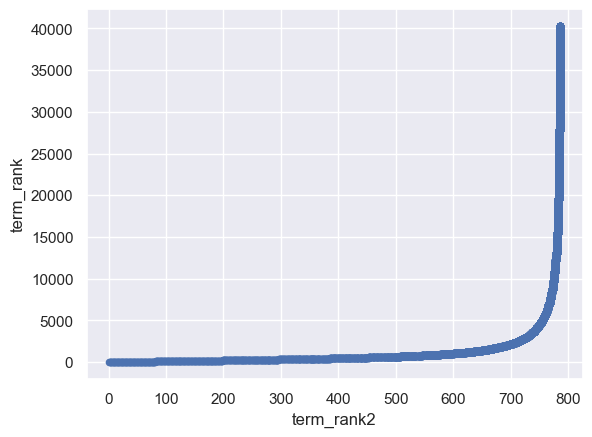

In [22]:
VOCAB.plot.scatter('term_rank2', 'term_rank');

## Compute Zipf's K

Now we see if K is linear as it's supposed to be.

In [23]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.p * VOCAB.term_rank2

## Visualize

###  Rank and N

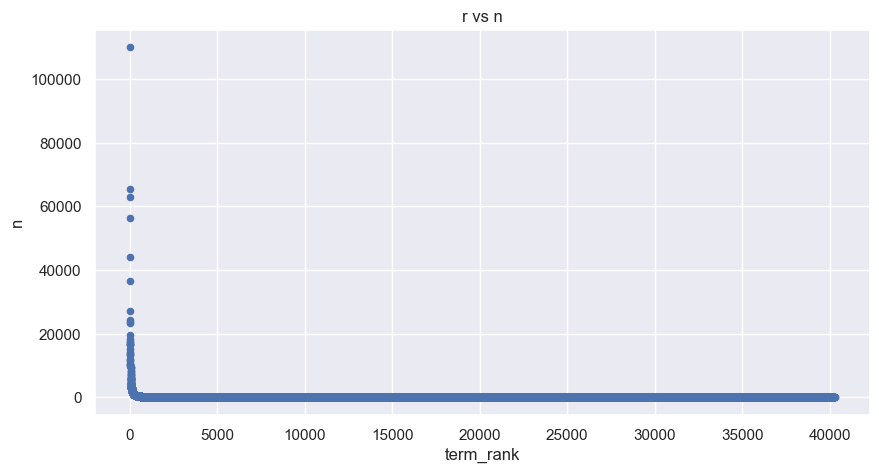

In [24]:
VOCAB.plot.scatter('term_rank', 'n', figsize=(10,5), title="r vs n");

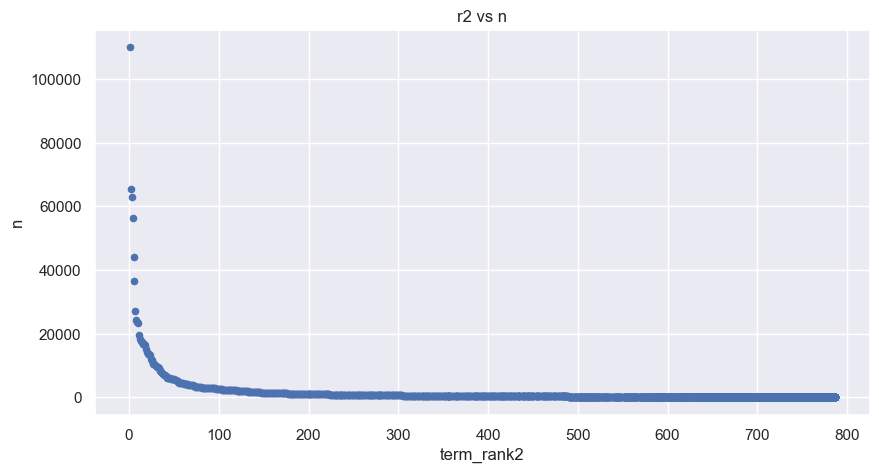

In [25]:
VOCAB.plot.scatter('term_rank2', 'n', figsize=(10,5), title="r2 vs n");

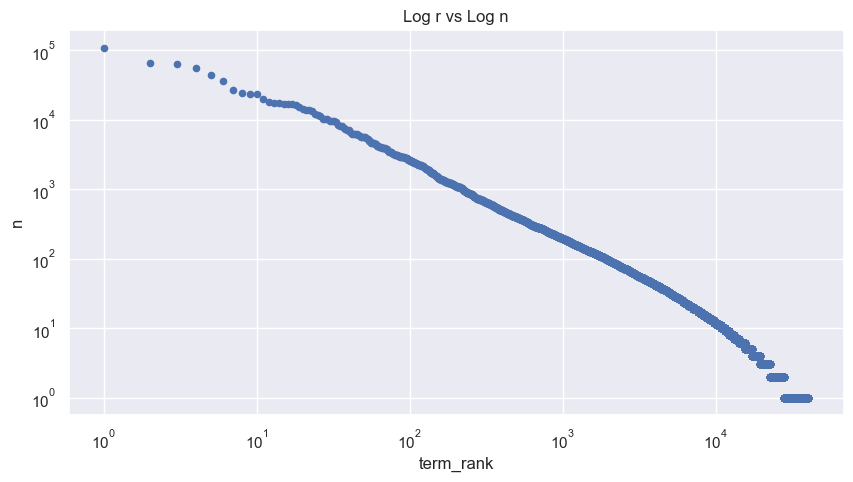

In [26]:
VOCAB.plot.scatter('term_rank', 'n', figsize=(10,5), logx=True, logy=True, title="Log r vs Log n");

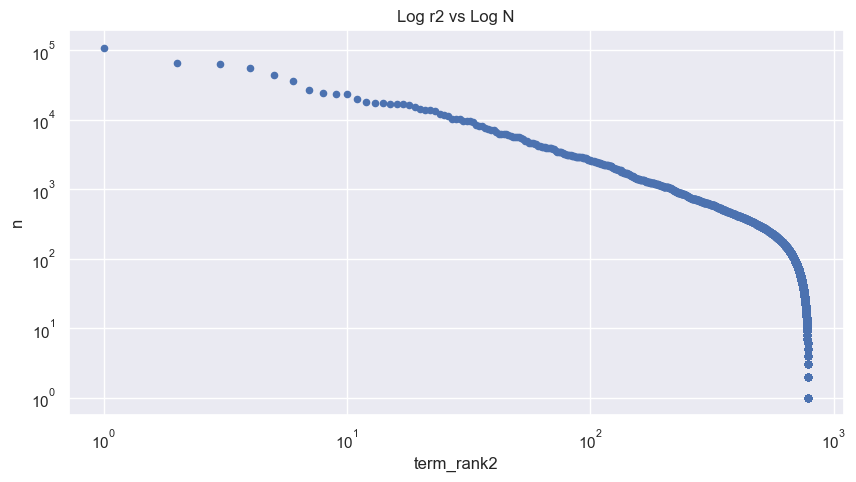

In [27]:
VOCAB.plot.scatter('term_rank2', 'n', figsize=(10,5), logx=True, logy=True, title="Log r2 vs Log N");

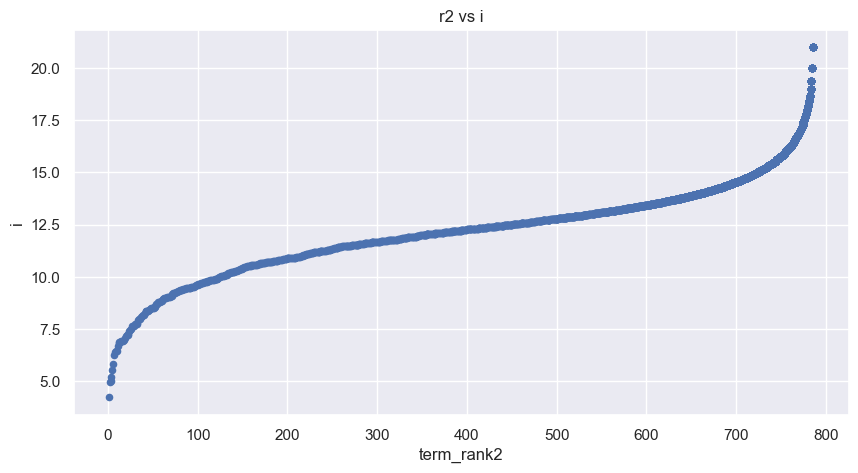

In [28]:
VOCAB.plot.scatter('term_rank2', 'i', figsize=(10,5), logx=False, logy=False, title="r2 vs i");

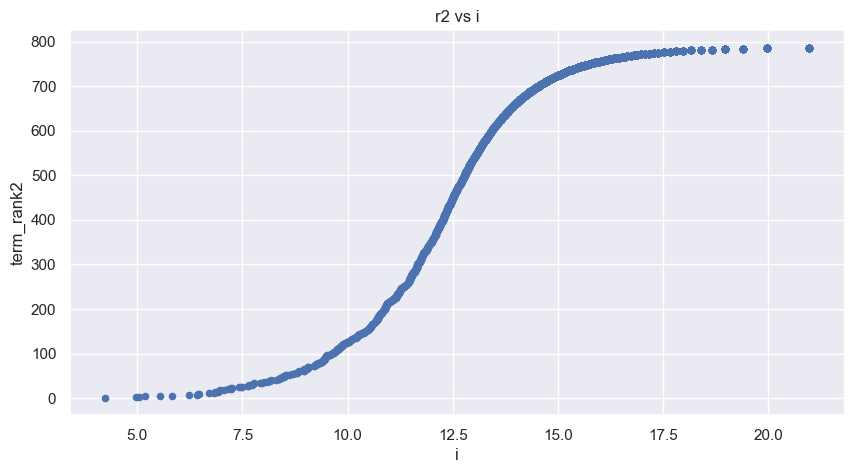

In [29]:
VOCAB.plot.scatter('i', 'term_rank2', figsize=(10,5), logx=False, logy=False, title="r2 vs i");

Is $i$ a normalized variant of $r$?

### Rank and Zipf $k$

$k$ is supposed to be constant.

In [30]:
# VOCAB.plot.scatter('term_rank', 'zipf_k', figsize=(10,5));

In [31]:
# VOCAB.plot.scatter('term_rank2', 'zipf_k2',  figsize=(10,5));

Look at low $k$ terms.

In [32]:
print(VOCAB[VOCAB.zipf_k2 <= VOCAB.zipf_k2.quantile(.1)].sort_values('zipf_k', ascending=True).head(10).index.to_list())

['wily', 'coordinates', 'teeter', 'contriver', 'clysters', 'coping', 'copernicus', 'windrows', 'tinkerings', 'teetered']


Look at high $k$ terms.

In [33]:
print(VOCAB[VOCAB.zipf_k2 >= VOCAB.zipf_k2.quantile(.9)].sort_values('zipf_k', ascending=False).head(10).index.to_list())

['is', 'him', 'from', 'at', 'by', 'my', 'this', 'but', 'all', 'be']


### Demo Rank Index

We look at a sample drawn from rank increments to see global patterns in the corpus.

In [34]:
rank_index = [1, 2, 3, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000]

In [36]:
demo = VOCAB.loc[VOCAB.term_rank.isin(rank_index)][['max_pos', 'p', 'term_rank', 'term_rank2', 'i', 'zipf_k', 'zipf_k2']]

In [37]:
demo.style.background_gradient(cmap=gradient_cmap, high=.5)

,max_pos,p,term_rank,term_rank2,i,zipf_k,zipf_k2
term_str,,,,,,,
the,DT,0.053387,1,1,4.227375,109921,0.053387
of,IN,0.031824,2,2,4.973725,131050,0.063649
and,CC,0.030576,3,3,5.031473,188862,0.091727
it,PR,0.011316,10,10,6.465503,232990,0.113159
you,PR,0.006968,20,20,7.165021,286940,0.139362
so,RB,0.004730,30,30,7.724073,292140,0.141887
their,PR,0.003438,40,40,8.184357,283120,0.137506
are,VB,0.002770,50,50,8.495725,285200,0.138517
will,MD,0.002192,60,60,8.833292,270840,0.131542


## Rank as Information

If we replace frequency $n$ with relative frequency as an estimate of probability $p$, it is easy to see that rank and information are closely related.

Information $i$ is just the log normalized value of rank, expressed as inverse probability, or surprise $s$. 

We see also that $i$ provides a smoother distribution.

In [38]:
VOCAB['term_rank2_log2'] = np.log2(VOCAB.term_rank2)
VOCAB['term_rank_log2'] = np.log2(VOCAB.term_rank)

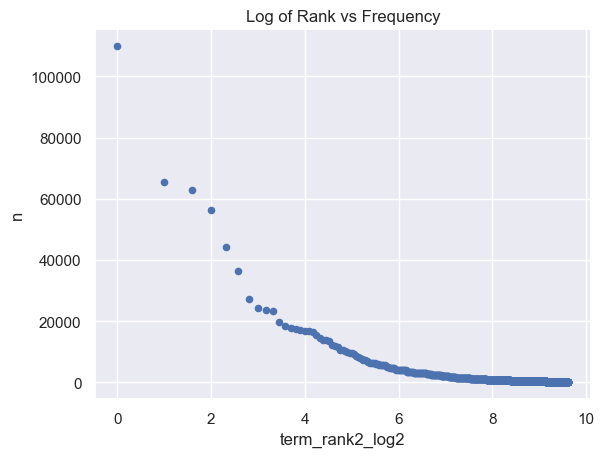

In [39]:
VOCAB.plot.scatter('term_rank2_log2', 'n', title="Log of Rank vs Frequency");

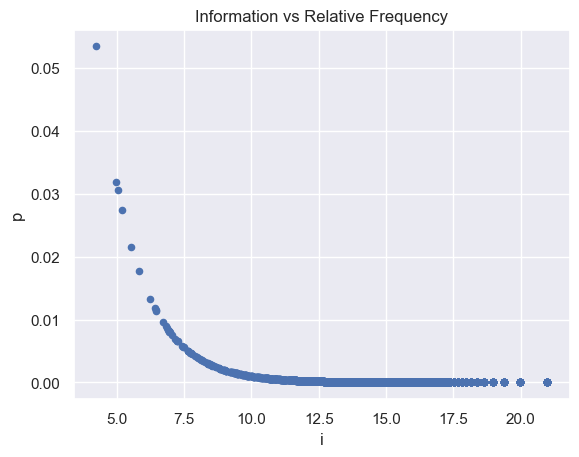

In [40]:
VOCAB.plot.scatter('i','p', title="Information vs Relative Frequency");

## Observations

* Zipf's law sheds light on a basic structure of language -- the division between words that do **grammatical work** and those that do **semantic work**.
* Zipf's constant is not borne out by the data. 
* Zipf's rank order does not group words with the same count; so, we've created an alternate rank based on word count groupings.
* Information $i$ may be used as a replacement for rank when exploring corpus level significance trends.

# Create BOW from TOKEN

We can create a BOW with a **split-apply-combine** pattern that counts instances of words for each bag.

In [41]:
BOW = TOKEN.groupby(bag+['term_str']).term_str.count().to_frame('n') 

In [42]:
BOW.head()

n
book_id chap_num term_str   
105     1        1         2
                 15        1
                 16        1
                 1760      1
                 1784      1

# Document-Term Count Matrix

We create a document-term count matrix simply bu **unstacking** the BOW, which converts it from a narrow to a wide representation. 

Note, these operations are slower than using `groupby()`.

In [43]:
DTCM = BOW.n.unstack().fillna(0).astype('int')

In [44]:
DTCM.head(10)

term_str          0  1  10  100  1000  10000  1000000  10000000  10440  10800  \
book_id chap_num                                                                
105     1         0  2   0    0     0      0        0         0      0      0   
        2         0  0   0    0     0      0        0         0      0      0   
        3         0  0   0    0     0      0        0         0      0      0   
        4         0  0   0    0     0      0        0         0      0      0   
        5         0  0   0    0     0      0        0         0      0      0   
        6         0  0   0    0     0      0        0         0      0      0   
        7         0  0   0    0     0      0        0         0      0      0   
        8         0  0   0    0     0      0        0         0      0      0   
        9         0  0   0    0     0      0        0         0      0      0   
        10        0  0   0    0     0      0        0         0      0      0   

term_str          ...  zoroaster  zozo  zuma  zur  à  æneas  æniad  æson  \
book_id chap_num  ...                                                      
105     1         ...          0     0     0    0  0      0      0     0   
        2         ...          0     0     0    0  0      0      0     0   
        3         ...          0     0     0    0  0      0      0     0   
        4         ...          0     0     0    0  0      0      0     0   
        5         ...          0     0     0    0  0      0      0     0   
        6         ...          0     0     0    0  0      0      0     0   
        7         ...          0     0     0    0  0      0      0     0   
        8         ...          0     0     0    0  0      0      0     0   
        9         ...          0     0     0    0  0      0      0     0   
        10        ...          0     0     0    0  0      0      0     0   

term_str          æsops  ł20000  
book_id chap_num                 
105     1             0       0  
        2             0       0  
        3             0       0  
        4             0       0  
        5             0       0  
        6             0       0  
        7             0       0  
        8             0       0  
        9             0       0  
        10            0       0  

[10 rows x 40478 columns]

In [45]:
DTCM.sum()

term_str
0          2
1         18
10         6
100        2
1000       2
          ..
æneas      1
æniad      1
æson       2
æsops      1
ł20000     1
Length: 40478, dtype: int64

## Pause and explore DOC table

DOC is a table of bags.

In [46]:
DOC = DTCM.sum(1).to_frame('n_tokens')
DOC['n_types'] = DTCM.astype('bool').sum(1)

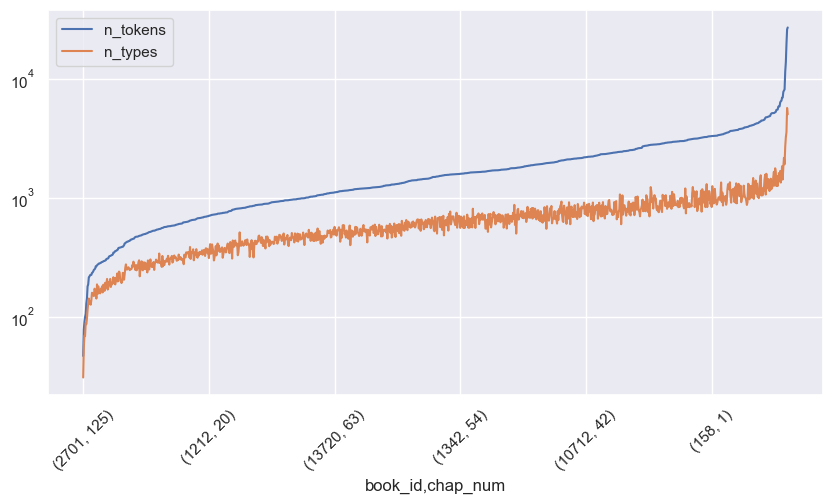

In [47]:
DOC.sort_values('n_tokens').plot(logy=True, figsize=(10, 5), rot=45);

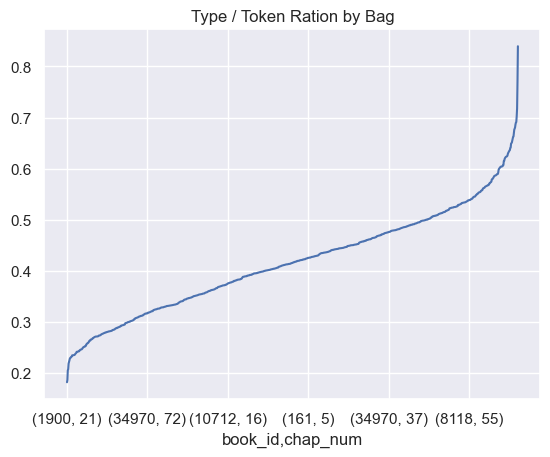

In [48]:
(DOC.n_types / DOC.n_tokens).sort_values().plot(title="Type / Token Ration by Bag");

# Compute TFIDF

## Compute TF

In [49]:
# We could do all this directly in the BOW table
# BOW.groupby(['book_id','chap_num']).apply(lambda x: x.n / x.n.sum())

In [50]:
print('TF method:', tf_method)
if tf_method == 'sum':
    TF = DTCM.T / DTCM.T.sum()
elif tf_method == 'max':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'log':
    TF = np.log2(1 + DTCM.T)
elif tf_method == 'raw':
    TF = DTCM.T
elif tf_method == 'double_norm':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'binary':
    TF = DTCM.T.astype('bool').astype('int')
TF = TF.T

TF method: sum


In [51]:
TF.head()

term_str            0         1   10  100  1000  10000  1000000  10000000  \
book_id chap_num                                                            
105     1         0.0  0.000762  0.0  0.0   0.0    0.0      0.0       0.0   
        2         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        3         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        4         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        5         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   

term_str          10440  10800  ...  zoroaster  zozo  zuma  zur    à  æneas  \
book_id chap_num                ...                                           
105     1           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        2           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        3           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        4           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        5           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   

term_str          æniad  æson  æsops  ł20000  
book_id chap_num                              
105     1           0.0   0.0    0.0     0.0  
        2           0.0   0.0    0.0     0.0  
        3           0.0   0.0    0.0     0.0  
        4           0.0   0.0    0.0     0.0  
        5           0.0   0.0    0.0     0.0  

[5 rows x 40478 columns]

## Compute DF

In [89]:
DF = DTCM.astype('bool').sum()

In [90]:
DF

term_str
0          1
1         11
10         5
100        2
1000       2
          ..
æneas      1
æniad      1
æson       1
æsops      1
ł20000     1
Length: 40478, dtype: int64

## Compute IDF

In [54]:
N = DTCM.shape[0]

In [55]:
print('IDF method:', idf_method)
if idf_method == 'standard':
    IDF = np.log2(N / DF)
elif idf_method == 'max':
    IDF = np.log2(DF.max() / DF) 
elif idf_method == 'smooth':
    IDF = np.log2((1 + N) / (1 + DF)) + 1

IDF method: standard


In [56]:
IDF

term_str
0         10.131857
1          6.672425
10         7.809929
100        9.131857
1000       9.131857
            ...    
æneas     10.131857
æniad     10.131857
æson      10.131857
æsops     10.131857
ł20000    10.131857
Length: 40478, dtype: float64

## Compute TFIDF

In [57]:
TFIDF = TF * IDF

In [58]:
TFIDF.head()

term_str            0         1   10  100  1000  10000  1000000  10000000  \
book_id chap_num                                                            
105     1         0.0  0.005084  0.0  0.0   0.0    0.0      0.0       0.0   
        2         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        3         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        4         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   
        5         0.0  0.000000  0.0  0.0   0.0    0.0      0.0       0.0   

term_str          10440  10800  ...  zoroaster  zozo  zuma  zur    à  æneas  \
book_id chap_num                ...                                           
105     1           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        2           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        3           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        4           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   
        5           0.0    0.0  ...        0.0   0.0   0.0  0.0  0.0    0.0   

term_str          æniad  æson  æsops  ł20000  
book_id chap_num                              
105     1           0.0   0.0    0.0     0.0  
        2           0.0   0.0    0.0     0.0  
        3           0.0   0.0    0.0     0.0  
        4           0.0   0.0    0.0     0.0  
        5           0.0   0.0    0.0     0.0  

[5 rows x 40478 columns]

## Move things to their places

In [59]:
VOCAB['df'] = DF
VOCAB['idf'] = IDF

In [60]:
BOW['tf'] = TF.stack()
BOW['tfidf'] = TFIDF.stack()

## Apply aggregates to VOCAB

In [100]:
VOCAB['tfidf_mean'] = TFIDF.mean() 
VOCAB['tfidf_sum'] = TFIDF.sum()
VOCAB['tfidf_median'] = TFIDF.median()
VOCAB['tfidf_max'] = TFIDF.max()

In [101]:
VOCAB.tfidf_mean

term_str
the            0.000000
of             0.000000
and            0.000079
to             0.000034
a              0.000055
                 ...   
glib           0.000007
glentinebay    0.000006
glenford       0.000008
glendin        0.000003
ł20000         0.000002
Name: tfidf_mean, Length: 40278, dtype: float64

## Add DFIDF and DH

In [72]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf

In [73]:
VOCAB['dp'] = VOCAB.df / len(DOC)

In [74]:
VOCAB['dh'] = VOCAB.dp * np.log2(1/VOCAB.dp)

## Observe results

In [75]:
VOCAB.sample(50).sort_values('i', ascending=True)[['max_pos', 'i','tfidf_mean','tfidf_median','tfidf_max', 'dfidf', 'dh']].style.background_gradient(cmap=gradient_cmap)

,max_pos,i,tfidf_mean,tfidf_median,tfidf_max,dfidf,dh
term_str,,,,,,,
closed,VB,13.744664,0.000233,0.000000,0.011867,376.082232,0.335189
rock,NN,13.984798,0.000233,0.000000,0.013756,275.018800,0.245115
maam,NN,14.103118,0.000228,0.000000,0.073139,215.131601,0.191739
temple,NN,14.764030,0.000248,0.000000,0.025640,218.250934,0.194520
speeches,NN,15.844200,0.000064,0.000000,0.009287,145.178175,0.129392
incurable,JJ,16.329627,0.000070,0.000000,0.010015,128.990785,0.114965
forbear,VB,16.449921,0.000057,0.000000,0.007888,128.990785,0.114965
compose,VB,16.725555,0.000034,0.000000,0.005155,102.754700,0.091582
asks,VB,17.514051,0.000032,0.000000,0.010815,68.099289,0.060695


# Visualize

Try to pick the best aggregate statistic.

## Information and TFIDF Mean 

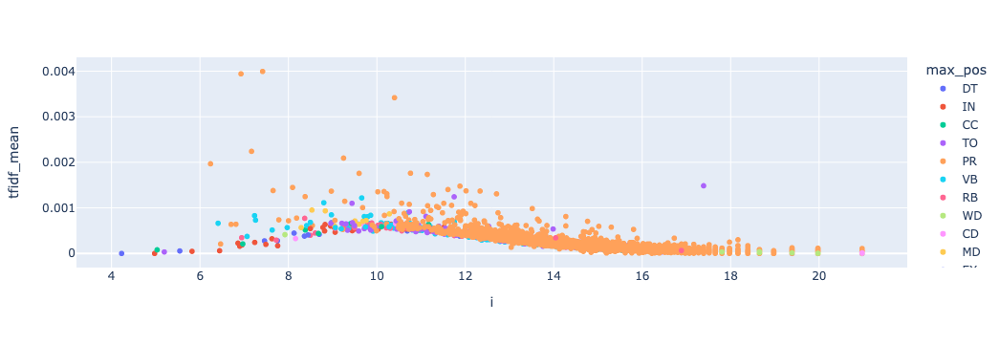

In [76]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_mean', hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False)

## Information and TFIDF Median

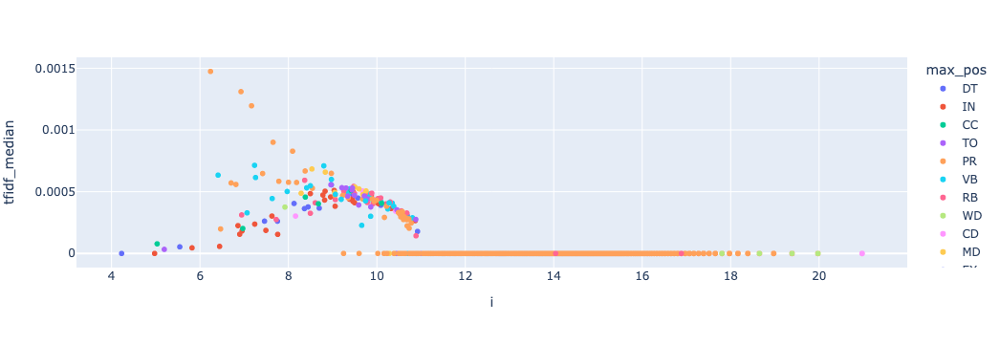

In [77]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_median', hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False)

## Information and TFIDF Max

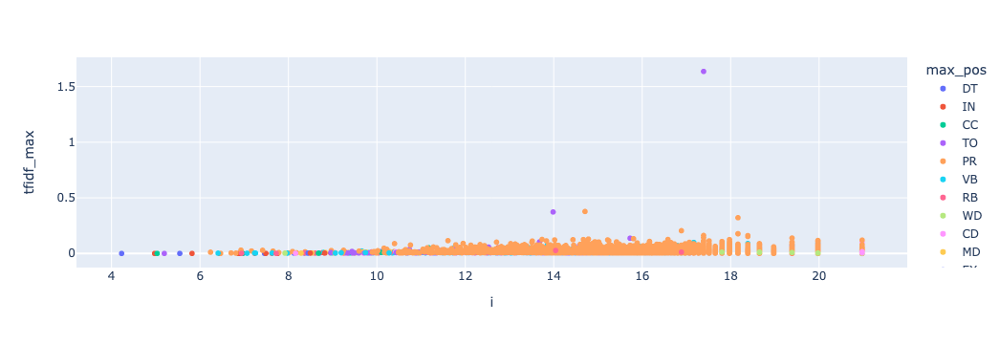

In [78]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_max', hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False)

## Information and TFIDF Sum

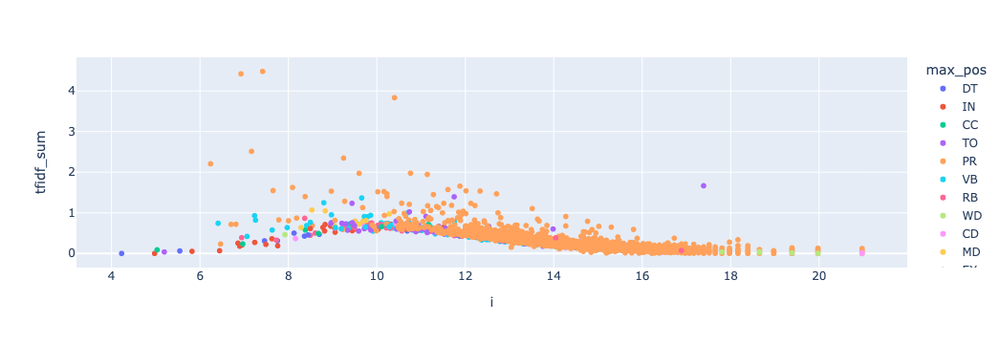

In [79]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_sum', hover_name='term_str', hover_data=['n'], color='max_pos')

## Information and DFIDF / DH

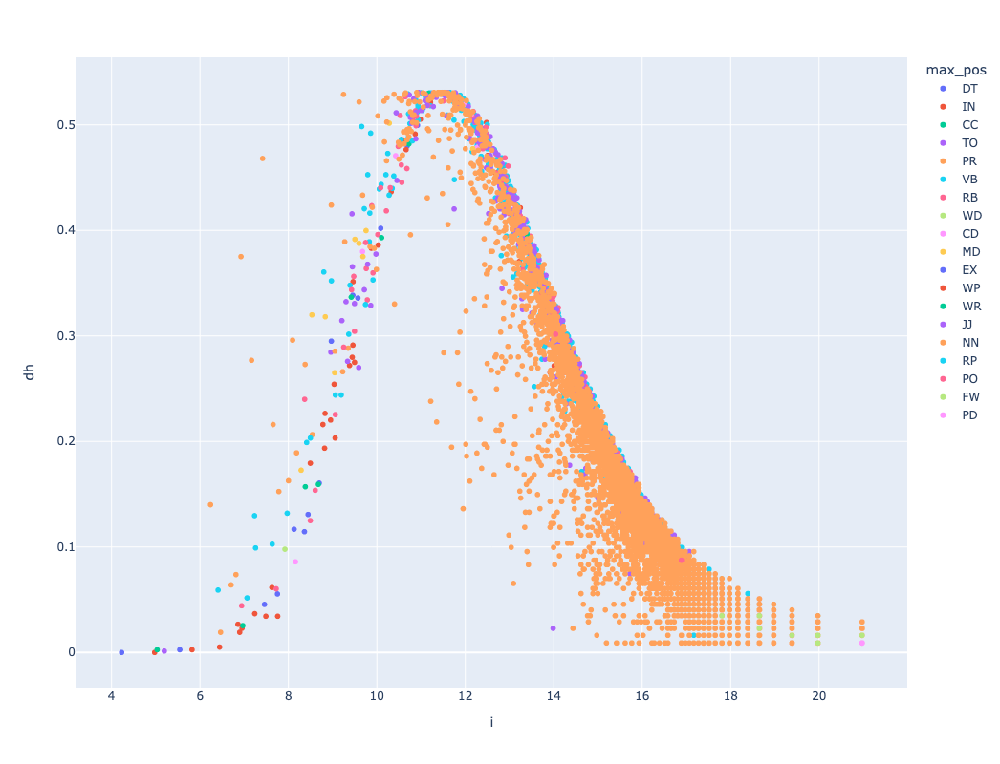

In [80]:
px.scatter(VOCAB.reset_index(), x='i', y='dh', hover_name='term_str', hover_data=['n'], color='max_pos', height=800)

## Demo Table

In [81]:
demo2 = VOCAB.loc[VOCAB.term_rank.isin(rank_index), ['max_pos', 'i', 'tfidf_mean', 'tfidf_median', 'tfidf_sum', 'tfidf_max', 'dfidf', 'dh']]

In [82]:
demo2.style.background_gradient(cmap=gradient_cmap)

,max_pos,i,tfidf_mean,tfidf_median,tfidf_sum,tfidf_max,dfidf,dh
term_str,,,,,,,,
the,DT,4.227375,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
of,IN,4.973725,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
and,CC,5.031473,0.000079,0.000078,0.088787,0.000186,2.882817,0.002569
it,PR,6.465503,0.000208,0.000199,0.233207,0.000801,21.495121,0.019158
you,PR,7.165021,0.002240,0.001196,2.513685,0.022266,310.618692,0.276844
so,RB,7.724073,0.000293,0.000275,0.329227,0.001022,67.746505,0.060380
their,PR,8.184357,0.000777,0.000575,0.871744,0.006124,212.307769,0.189223
are,VB,8.495725,0.000683,0.000548,0.766283,0.004542,228.069595,0.203271
will,MD,8.833292,0.000935,0.000659,1.049106,0.009406,356.913125,0.318104


# Reduce VOCAB

## Select Significant Terms based on DFIDF

In [83]:
len(VOCAB)

40278

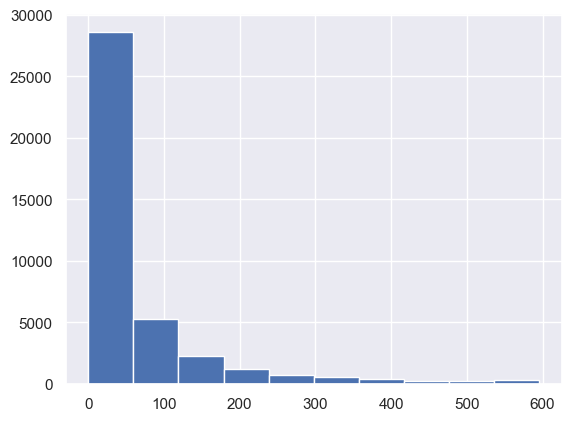

In [84]:
VOCAB.dfidf.hist();

In [85]:
SIGS = VOCAB.sort_values('dfidf', ascending=False).head(4000)

In [86]:
SIGS[['max_pos', 'n', 'i', 'dh']].head(100).style.background_gradient(cmap=gradient_cmap)

,max_pos,n,i,dh
term_str,,,,
hands,NN,771,11.382896,0.530737
sure,JJ,1047,10.941437,0.530737
short,JJ,699,11.524334,0.530735
new,JJ,763,11.397944,0.530726
word,NN,725,11.471646,0.530726
passed,VB,696,11.530539,0.530722
fine,JJ,719,11.483635,0.530716
name,NN,724,11.473637,0.530710
sight,NN,687,11.549317,0.530702


# Save Work

In [87]:
save_path = f"{data_out}/{data_prefix}"
VOCAB.to_csv(f'{save_path}-VOCAB2.csv')
TOKEN.to_csv(f'{save_path}-TOKEN2.csv')
BOW.to_csv(f'{save_path}-BOW.csv')
DTCM.to_csv(f'{save_path}-DTCM.csv')
TFIDF.to_csv(f'{save_path}-TFIDF.csv')
SIGS.to_csv(f'{save_path}-SIGS.csv')
TFIDF[SIGS.index].to_csv(f'{save_path}-TFIDF_REDUCED.csv')
DOC.to_csv(f'{save_path}-CHAP_STATS.csv')